In [9]:
import os
import csv
import re
import pickle
import random
import math
import dicom
import numpy as np
from tqdm import tqdm
from scipy import ndimage
from natsort import natsorted

import matplotlib.pyplot as plt
%matplotlib inline
from PIL import Image

#### helper functions

In [10]:
def apply_window(arr, window_center, window_width):
    return np.clip(arr, window_center - window_width/2, window_center + window_width/2)

#### visualize pt 1

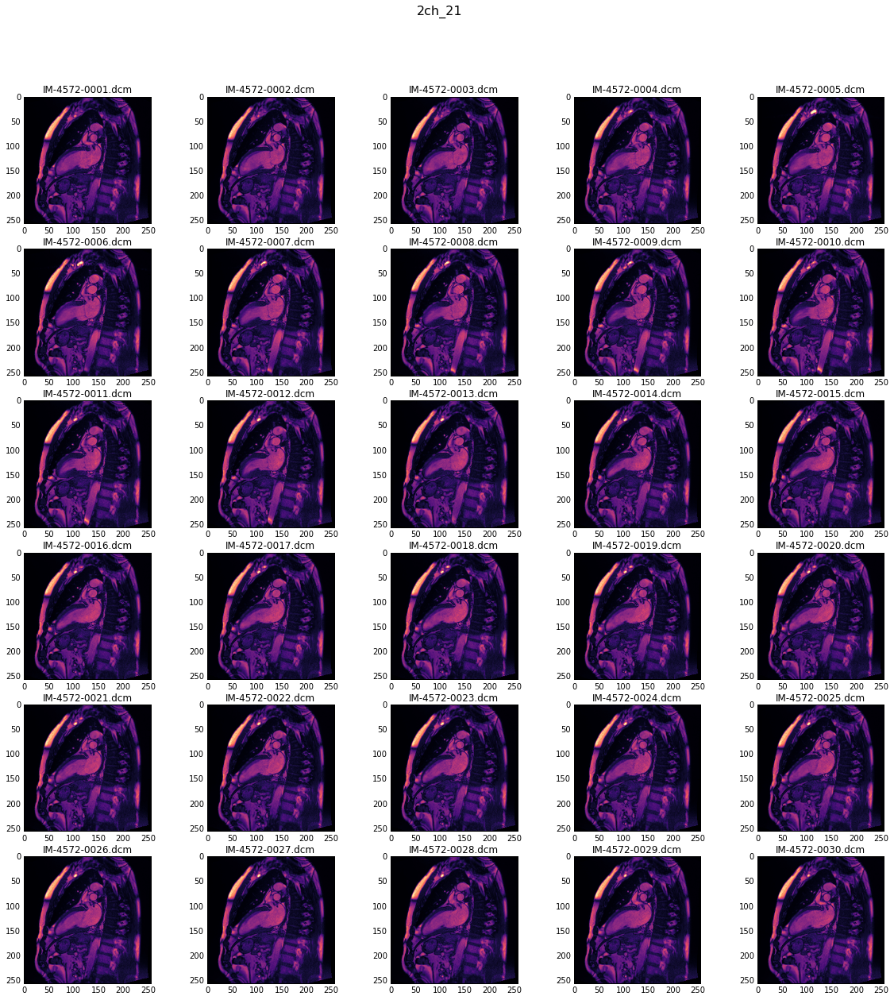

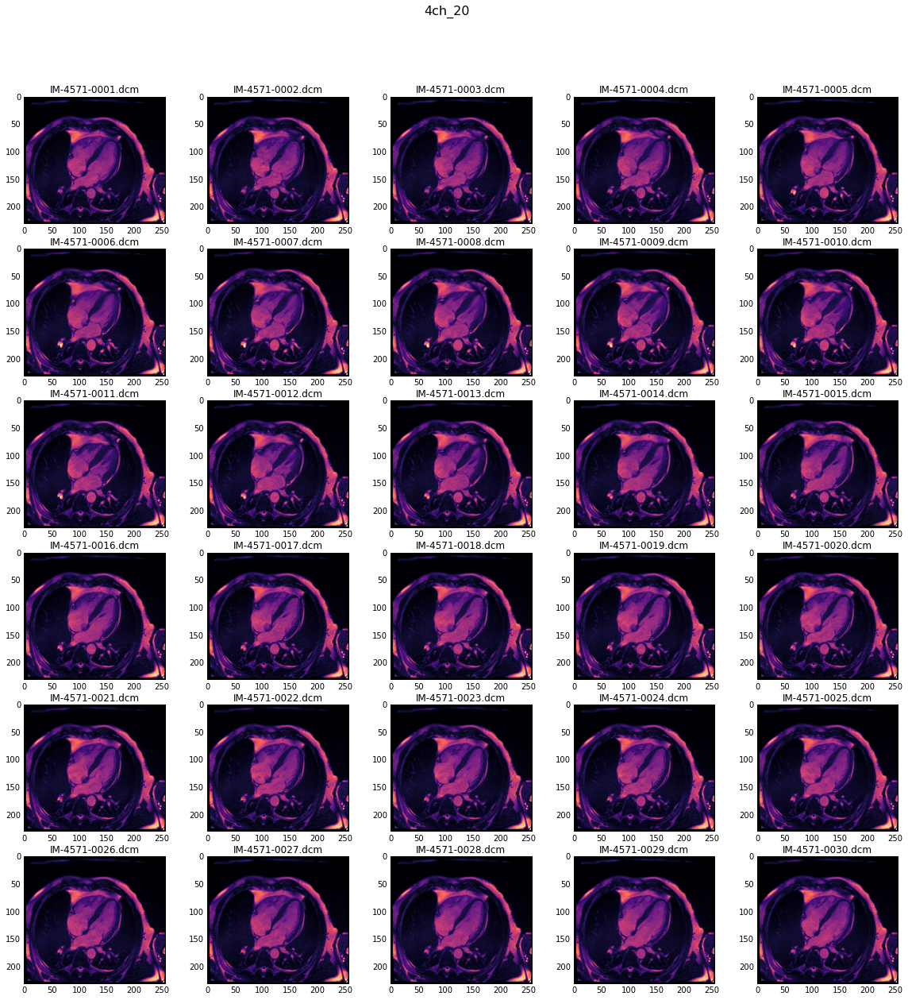

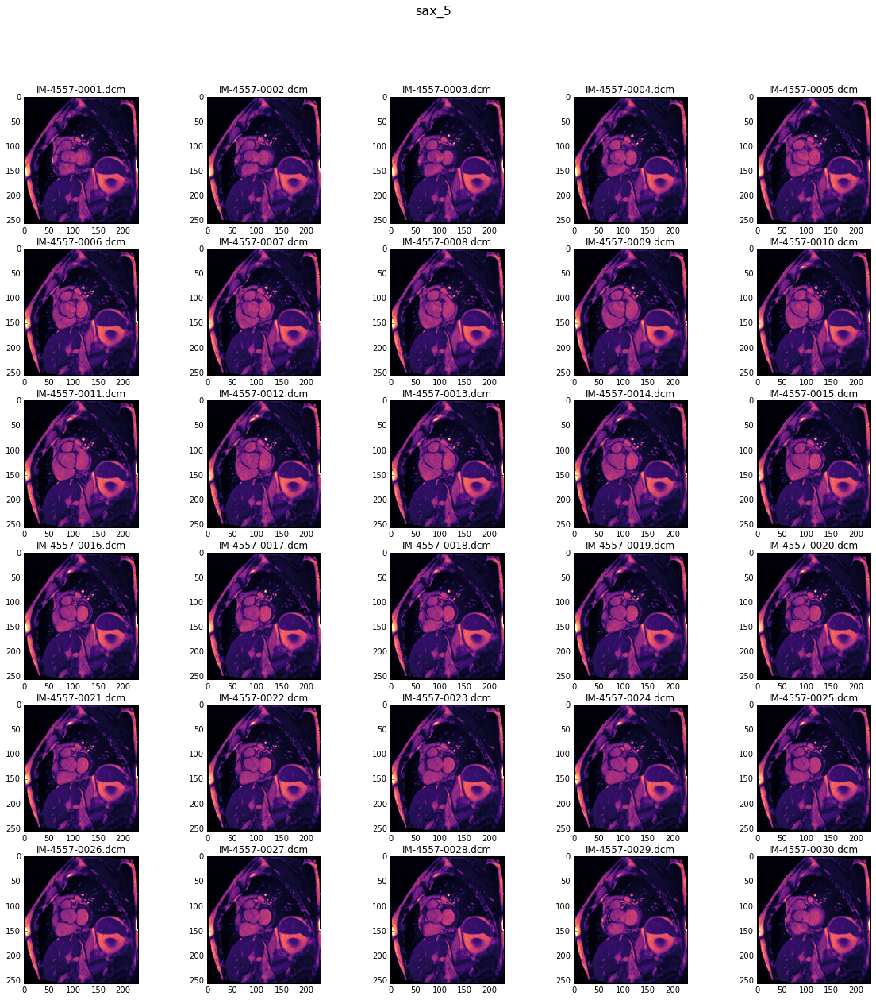

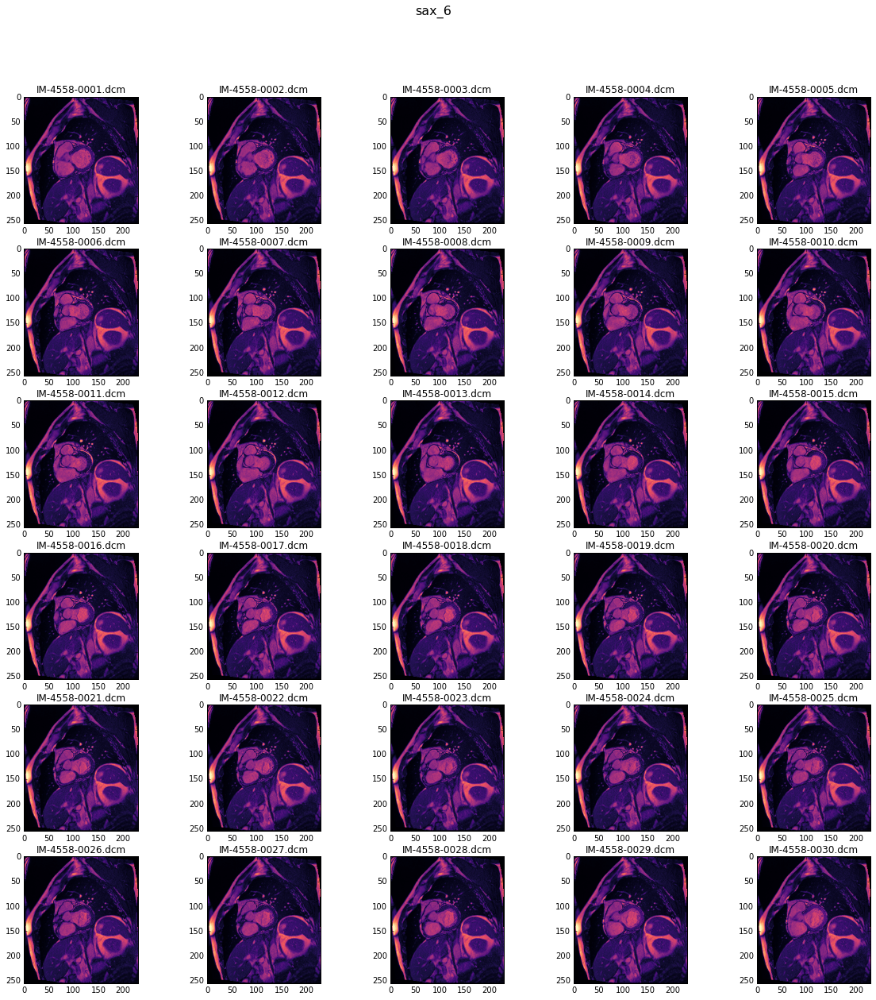

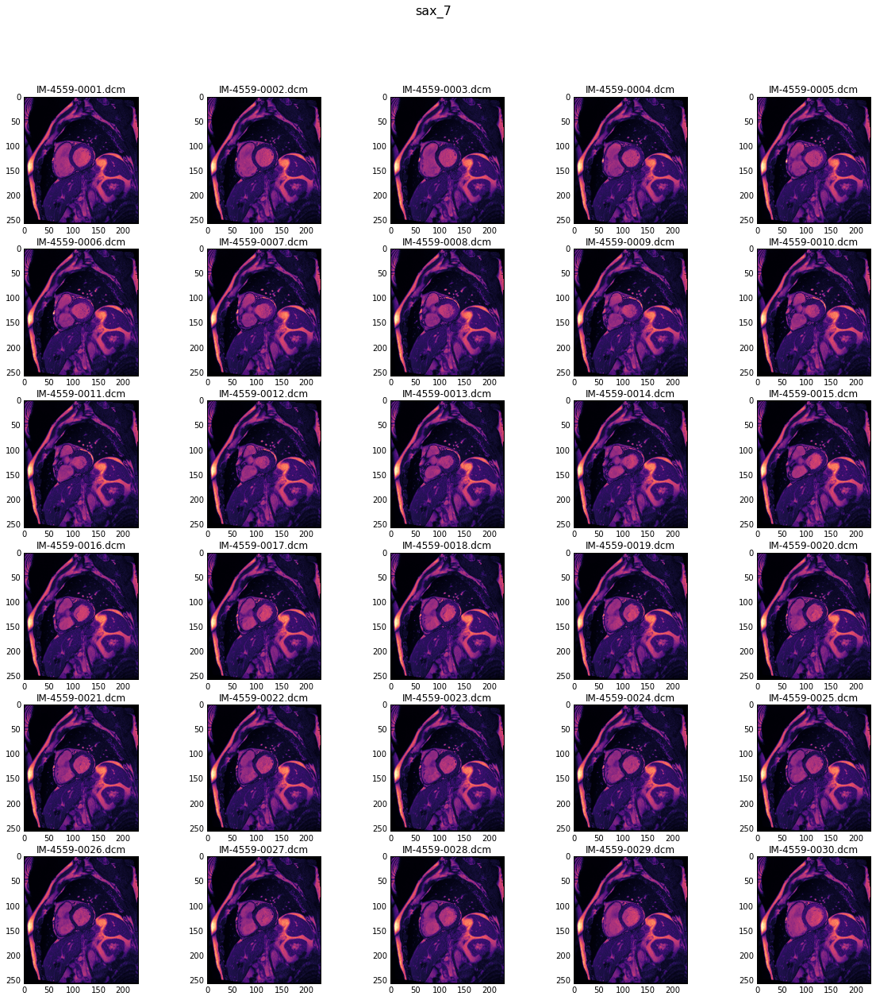

...

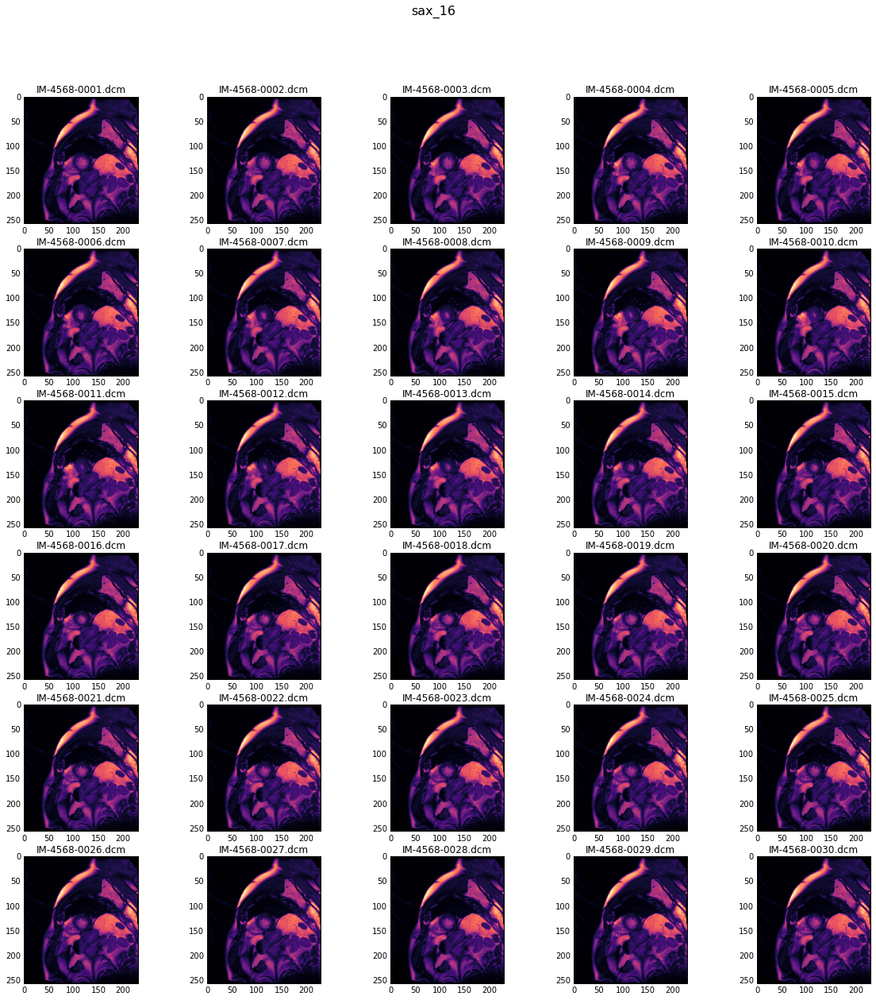

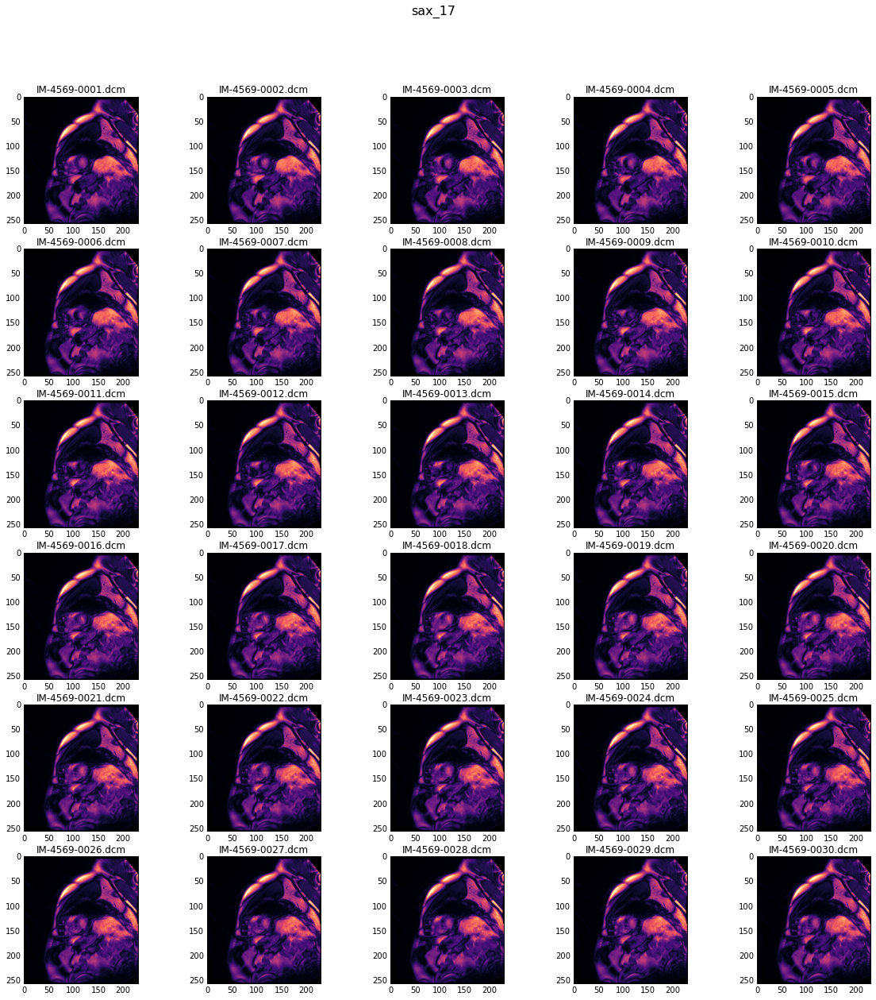

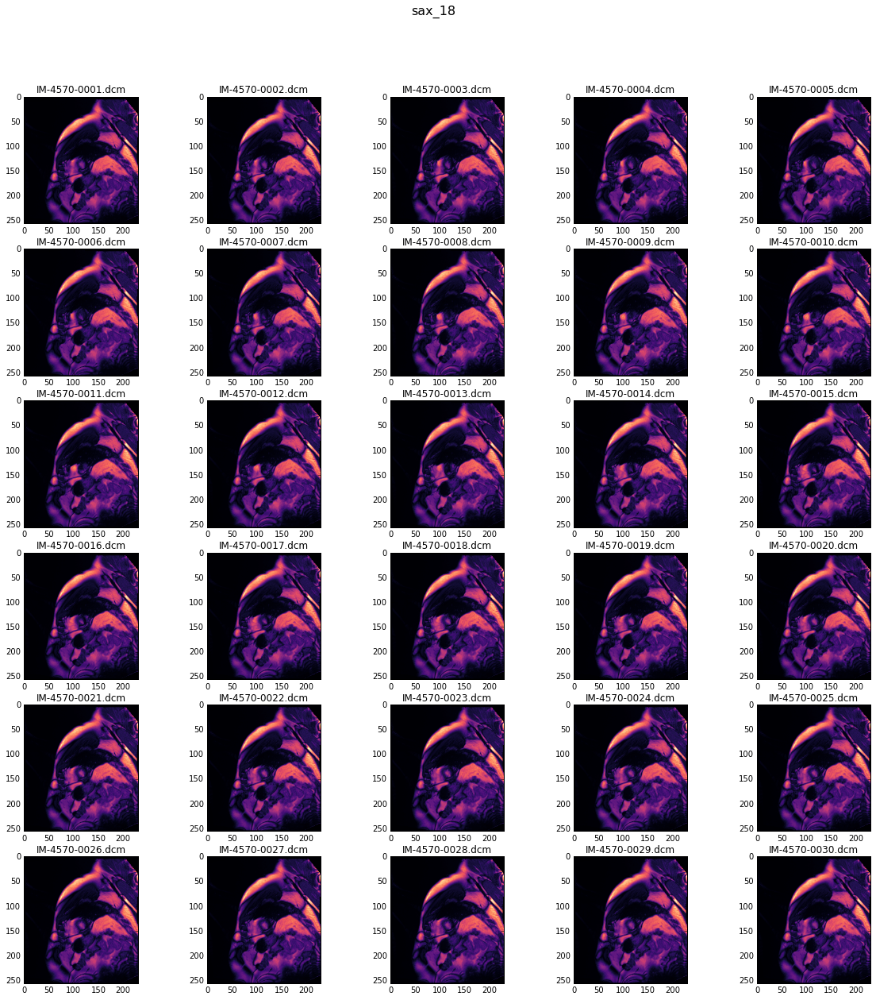

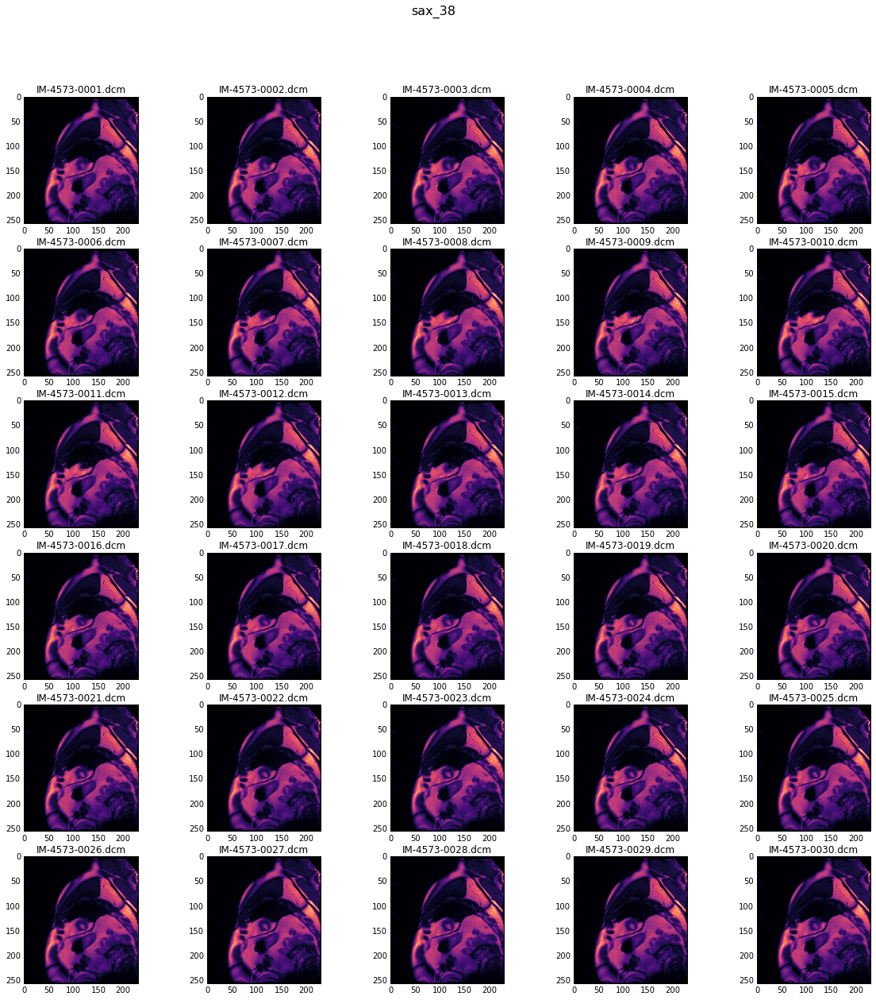

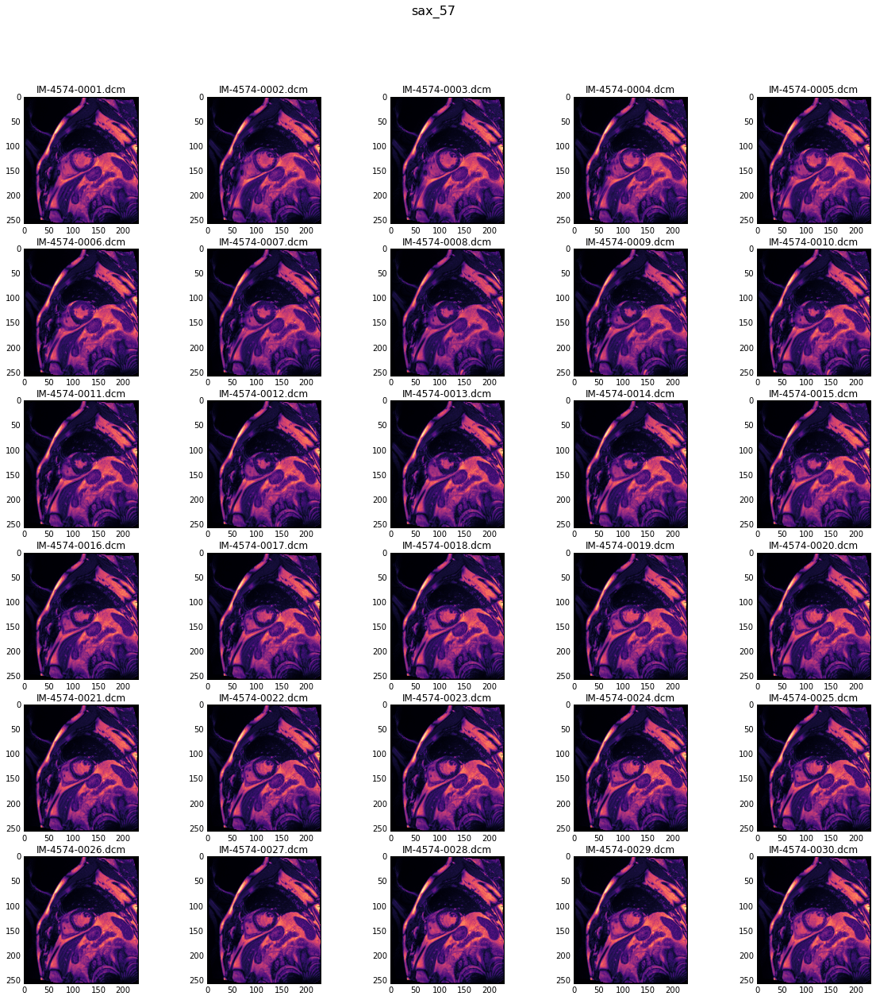

In [21]:
i = 1
window_center = 200
window_width = 600

folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/train/{}/study'.format(i)) if x.is_dir()])
for folder_name, folder_path in folders:
    plt.figure(figsize=(20,20))
    plt.suptitle(folder_name, fontsize=16)
    files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                       if x.is_file() and x.name.endswith('.dcm')])
    for i_slice, (file_name, file_path) in enumerate(files):
        plt.subplot(math.ceil(len(files) / 5), 5, i_slice+1)
        plt.title(file_name)
        plt.imshow(apply_window(dicom.read_file(file_path).pixel_array, window_center, window_width), cmap=plt.cm.magma)

#### slice numbers/sizes

In [28]:
i = 1

folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/train/{}/study'.format(i)) if x.is_dir()])
for folder_name, folder_path in folders:
    files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                       if x.is_file() and x.name.endswith('.dcm')])
    print('{}: {}'.format(folder_name, dicom.read_file(files[0][1]).pixel_array.shape))

2ch_21: (256, 256)
4ch_20: (230, 256)
sax_5: (256, 230)
sax_6: (256, 230)
sax_7: (256, 230)
sax_8: (256, 230)
sax_9: (256, 230)
sax_10: (256, 230)
sax_11: (256, 230)
sax_12: (256, 230)
sax_13: (256, 230)
sax_14: (256, 230)
sax_15: (256, 230)
sax_16: (256, 230)
sax_17: (256, 230)
sax_18: (256, 230)
sax_38: (256, 230)
sax_57: (256, 230)


In [51]:
x_min, y_min, x_max, y_max = 1000, 1000, 0, 0

for i in tqdm(range(1, 501)):
    folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/train/{}/study'.format(i)) \
                         if x.is_dir()])
    for folder_name, folder_path in folders:
        files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                           if x.is_file() and x.name.endswith('.dcm')])
        x, y = dicom.read_file(files[0][1]).pixel_array.shape
        if x < x_min:
            x_min = x
        if x > x_max:
            x_max = x
        if y < y_min:
            y_min = y
        if y > y_max:
            y_max = y

print(x_min, y_min, x_max, y_max)

166 166 736 736


number of frames in series (the rest have 30 frames per series)

In [53]:
for i in range(1, 501):
    folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/train/{}/study'.format(i)) \
                         if x.is_dir()])
    for folder_name, folder_path in folders:
        files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                           if x.is_file() and x.name.endswith('.dcm')])
        if len(files) != 30:
            print(len(files), folder_path)

270 /home/leon/ML/kaggle/dsb/data/train/123/study/sax_10
270 /home/leon/ML/kaggle/dsb/data/train/123/study/sax_20
60 /home/leon/ML/kaggle/dsb/data/train/234/study/sax_19
330 /home/leon/ML/kaggle/dsb/data/train/234/study/sax_20
60 /home/leon/ML/kaggle/dsb/data/train/279/study/2ch_6
60 /home/leon/ML/kaggle/dsb/data/train/279/study/4ch_8
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_9
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_10
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_11
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_12
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_13
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_14
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_15
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_16
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_17
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_18
60 /home/leon/ML/kaggle/dsb/data/train/279/study/sax_19
330 /home/leon/ML/kaggle/dsb/data/train/334/stud

In [54]:
for i in range(501, 701):
    folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/validate/{}/study'.format(i)) \
                         if x.is_dir()])
    for folder_name, folder_path in folders:
        files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                           if x.is_file() and x.name.endswith('.dcm')])
        if len(files) != 30:
            print(len(files), folder_path)

330 /home/leon/ML/kaggle/dsb/data/validate/516/study/sax_104
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/2ch_7
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/4ch_9
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_11
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_12
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_13
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_14
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_15
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_16
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_17
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_18
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_19
60 /home/leon/ML/kaggle/dsb/data/validate/590/study/sax_20
270 /home/leon/ML/kaggle/dsb/data/validate/597/study/sax_7
330 /home/leon/ML/kaggle/dsb/data/validate/619/study/sax_21
60 /home/leon/ML/kaggle/dsb/data/validate/623/study/sax

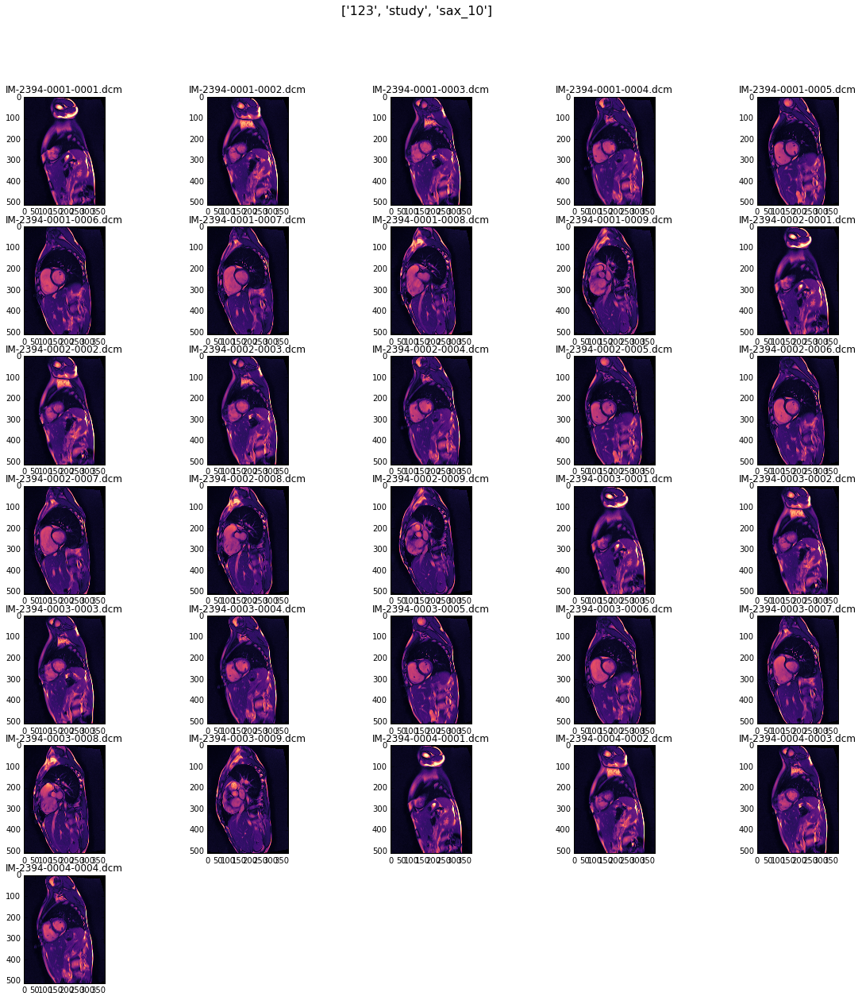

In [75]:
folder_path = '/home/leon/ML/kaggle/dsb/data/train/123/study/sax_10'
plt.figure(figsize=(20,20))
plt.suptitle(folder_path.split('/')[-3:], fontsize=16)
files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                   if x.is_file() and x.name.endswith('.dcm')])
for i_slice, (file_name, file_path) in enumerate(files):
    if i_slice > 30:
        break
    plt.subplot(7, 5, i_slice+1)
    plt.title(file_name)
    df = dicom.read_file(file_path)
    plt.imshow(apply_window(df.pixel_array, df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)

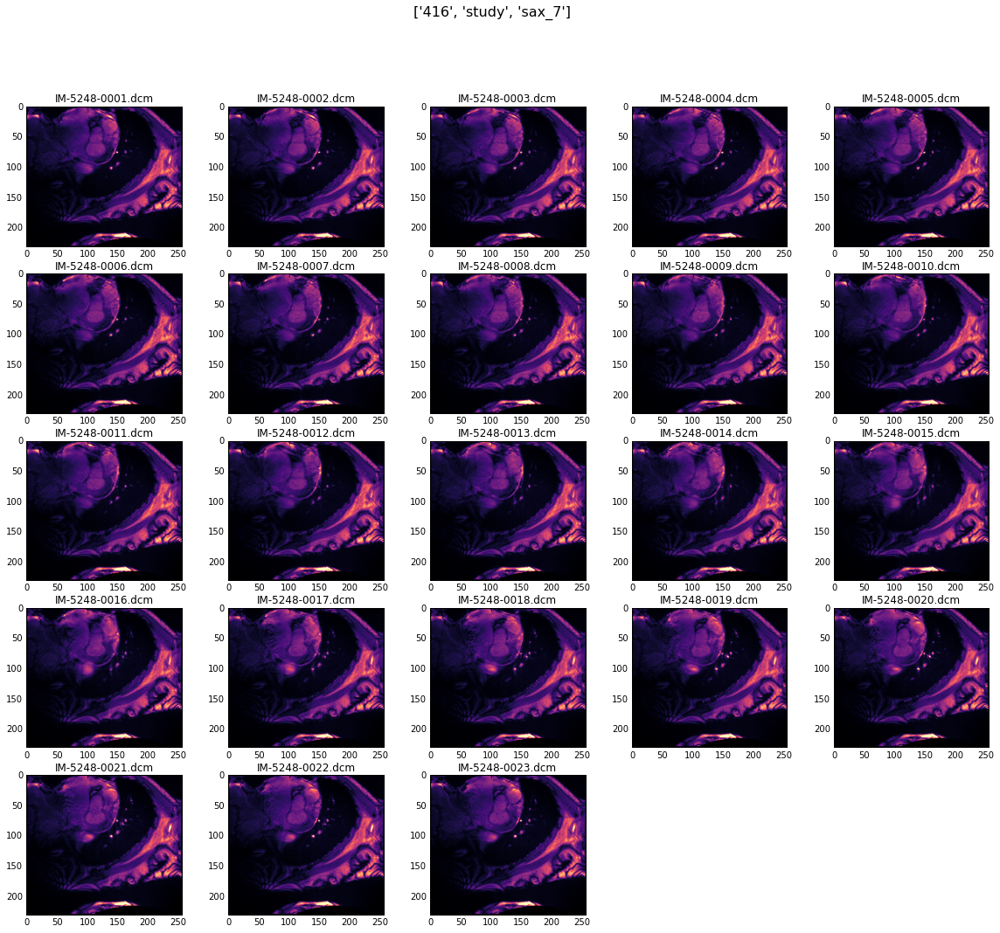

In [76]:
folder_path = '/home/leon/ML/kaggle/dsb/data/train/416/study/sax_7'
plt.figure(figsize=(20,20))
plt.suptitle(folder_path.split('/')[-3:], fontsize=16)
files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                   if x.is_file() and x.name.endswith('.dcm')])
for i_slice, (file_name, file_path) in enumerate(files):
    plt.subplot(6, 5, i_slice+1)
    plt.title(file_name)
    df = dicom.read_file(file_path)
    plt.imshow(apply_window(df.pixel_array, df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)

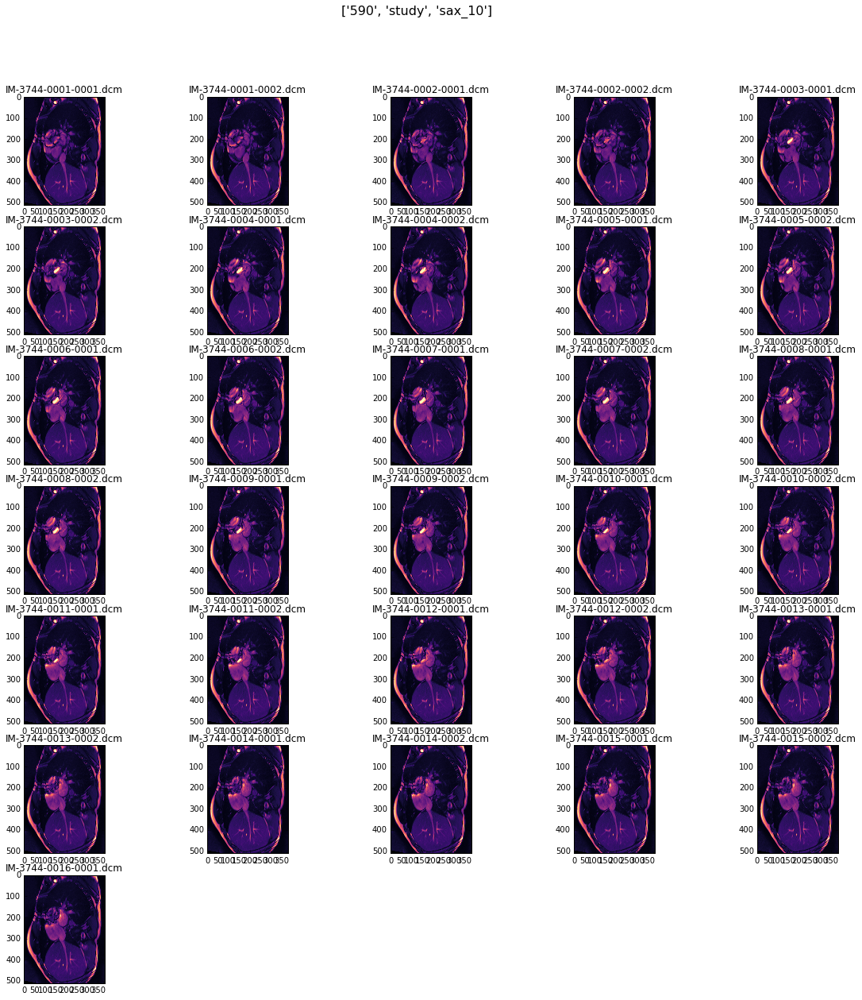

In [81]:
folder_path = '/home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10'
plt.figure(figsize=(20,20))
plt.suptitle(folder_path.split('/')[-3:], fontsize=16)
files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                   if x.is_file() and x.name.endswith('.dcm')])
for i_slice, (file_name, file_path) in enumerate(files):
    if i_slice > 30:
        break
    plt.subplot(7, 5, i_slice+1)
    plt.title(file_name)
    df = dicom.read_file(file_path)
    plt.imshow(apply_window(df.pixel_array, df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)

#### dicom metadata

In [56]:
df = dicom.read_file('../data/train/1/study/sax_5/IM-4557-0001.dcm')
print(df)

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'M', 'RETRO', 'NORM', 'DIS2D']
(0008, 0013) Instance Creation Time              TM: '143506.468000'
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.9590.100.1.2.155926562610379287424879000432859632760
(0008, 0030) Study Time                          TM: '141855.484000'
(0008, 0031) Series Time                         TM: '143506'
(0008, 0032) Acquisition Time                    TM: '143456.972500'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufacturer                        LO: 'SIEMENS'
(0008, 103e) Series Description                  LO: 'sax'
(0008, 1090) Manufacturer's Model Name           LO: 'Aera'
(0008, 1140)  Referenced Image Sequence   3 item(s) ---- 
   (0008, 1150) Referenced SOP Class UID            UI: MR Image Storag

In [57]:
print(df.WindowCenter, df.WindowWidth)

278 628


In [62]:
df = dicom.read_file('../data/validate/516/study/sax_104/IM-2698-0001-0001.dcm')
print(df)

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'M', 'RETRO', 'NORM', 'DIS2D', 'FM4_2', 'FIL']
(0008, 0013) Instance Creation Time              TM: '103139.377000'
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.9590.100.1.2.252746137513108145006395818511593737796
(0008, 0030) Study Time                          TM: '095124.051000'
(0008, 0031) Series Time                         TM: '103139.373000'
(0008, 0032) Acquisition Time                    TM: '103109.517500'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufacturer                        LO: 'SIEMENS'
(0008, 103e) Series Description                  LO: 'sax'
(0008, 1090) Manufacturer's Model Name           LO: 'Aera'
(0008, 1110)  Referenced Study Sequence   1 item(s) ---- 
   (0008, 1150) Referenced SOP Class UID        

In [40]:
print(dicom.read_file('../data/validate/516/study/sax_104/IM-2698-0001-0001.dcm').SliceLocation)
print(dicom.read_file('../data/validate/516/study/sax_104/IM-2698-0001-0002.dcm').SliceLocation)
print(dicom.read_file('../data/validate/516/study/sax_104/IM-2698-0002-0001.dcm').SliceLocation)
print(dicom.read_file('../data/validate/516/study/sax_104/IM-2698-0002-0002.dcm').SliceLocation)

-6.5830483807635
-16.583047448394
-6.5830483807635
-16.583047448394


In [77]:
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/416/study/sax_7/IM-5248-0001.dcm')
print(df)

(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'M', 'NORM', 'DIS2D']
(0008, 0013) Instance Creation Time              TM: '121820.234000'
(0008, 0016) SOP Class UID                       UI: MR Image Storage
(0008, 0018) SOP Instance UID                    UI: 1.3.6.1.4.1.9590.100.1.2.300755911212432756337910990700325545255
(0008, 0030) Study Time                          TM: '103521.771000'
(0008, 0031) Series Time                         TM: '121820'
(0008, 0032) Acquisition Time                    TM: '121812.690000'
(0008, 0060) Modality                            CS: 'MR'
(0008, 0070) Manufacturer                        LO: 'SIEMENS'
(0008, 103e) Series Description                  LO: 'sax'
(0008, 1090) Manufacturer's Model Name           LO: 'Skyra'
(0008, 1140)  Referenced Image Sequence   3 item(s) ---- 
   (0008, 1150) Referenced SOP Class UID            UI: MR Image Storage
   ---

In [44]:
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10/IM-3744-0001-0001.dcm')
print(df.StudyTime, df.SeriesTime, df.AcquisitionTime, df.SliceLocation, df.SeriesNumber, df.AcquisitionNumber, df.InstanceNumber)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10/IM-3744-0001-0002.dcm')
print(df.StudyTime, df.SeriesTime, df.AcquisitionTime, df.SliceLocation, df.SeriesNumber, df.AcquisitionNumber, df.InstanceNumber)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10/IM-3744-0002-0001.dcm')
print(df.StudyTime, df.SeriesTime, df.AcquisitionTime, df.SliceLocation, df.SeriesNumber, df.AcquisitionNumber, df.InstanceNumber)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/validate/590/study/sax_10/IM-3744-0002-0002.dcm')
print(df.StudyTime, df.SeriesTime, df.AcquisitionTime, df.SliceLocation, df.SeriesNumber, df.AcquisitionNumber, df.InstanceNumber)

140602.771000 142110.539000 142101.717500 19.372701841007 10 1 1
140602.771000 142110.539000 142101.717500 19.372701841007 10 1 1
140602.771000 142110.539000 142101.717500 19.372701841007 10 1 2
140602.771000 142110.539000 142101.717500 19.372701841007 10 1 2


In [7]:
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_37/IM-12984-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_38/IM-12985-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_39/IM-12986-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_40/IM-12987-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_41/IM-12988-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_42/IM-12989-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_43/IM-12990-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_44/IM-12991-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_45/IM-12992-0001.dcm')
print(df.SliceLocation, df.SliceThickness)
df = dicom.read_file('/home/leon/ML/kaggle/dsb/data/train/158/study/sax_46/IM-12993-0001.dcm')
print(df.SliceLocation, df.SliceThickness)

43.468095009638 8
33.468094308792 8
23.468091785143 8
13.468089525521 8
3.4680880385986 8
-6.5319160498316 8
-16.531917536754 8
-26.531920569075 8
-36.531920510598 8
-46.53192354292 8


#### create filepaths data

In [58]:
def create_filepaths_dict(dataset='train'):
    if dataset == 'train':
        nrange = range(1, 501)
    elif dataset == 'validate':
        nrange = range(501, 701)
    else:
        raise

    slice_filepaths = {}
    for i in tqdm(nrange):
        filepaths = {}
        folders = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir('../data/{}/{}/study'.format(dataset, i)) \
                             if x.is_dir()])
        for folder_name, folder_path in folders:
            files = natsorted([(x.name, os.path.abspath(x.path)) for x in os.scandir(folder_path) \
                               if x.is_file() and x.name.endswith('.dcm')])
            filepaths[folder_name] = files
        slice_filepaths[i] = filepaths
    
    return slice_filepaths

# save to file

with open('../data_supp/filepaths_train.pkl', 'wb') as f:
    slice_filepaths = create_filepaths_dict(dataset='train')
    pickle.dump(slice_filepaths, f)
with open('../data_supp/filepaths_val.pkl', 'wb') as f:
    slice_filepaths = create_filepaths_dict(dataset='validate')
    pickle.dump(slice_filepaths, f)

In [12]:
def get_filepaths():
    with open('../data_supp/filepaths_train.pkl', 'rb') as f:
        filepaths_train = pickle.load(f)
    with open('../data_supp/filepaths_val.pkl', 'rb') as f:
        filepaths_val = pickle.load(f)
    return filepaths_train, filepaths_val

#### additional exploration

do all studies include 2-chamber and 4-chamber views?

In [13]:
filepaths_train, filepaths_val = get_filepaths()

In [6]:
print('training set', end=': ')
for pt in filepaths_train.keys():
    if not any([re.match(r'^sax_', view) for view in filepaths_train[pt].keys()]):
        print(pt, end=', ')
print('\nval set', end=': ')
for pt in filepaths_val.keys():
    if not any([re.match(r'^sax_', view) for view in filepaths_val[pt].keys()]):
        print(pt, end=', ')

training set: 
val set: 

In [7]:
print('training set', end=': ')
for pt in filepaths_train.keys():
    if not any([re.match(r'^2ch_', view) for view in filepaths_train[pt].keys()]):
        print(pt, end=', ')
print('\nval set', end=': ')
for pt in filepaths_val.keys():
    if not any([re.match(r'^2ch_', view) for view in filepaths_val[pt].keys()]):
        print(pt, end=', ')

training set: 
val set: 

In [8]:
print('training set', end=': ')
for pt in filepaths_train.keys():
    if not any([re.match(r'^4ch_', view) for view in filepaths_train[pt].keys()]):
        print(pt, end=', ')
print('\nval set', end=': ')
for pt in filepaths_val.keys():
    if not any([re.match(r'^4ch_', view) for view in filepaths_val[pt].keys()]):
        print(pt, end=', ')

training set: 36, 74, 101, 116, 135, 144, 166, 176, 191, 200, 216, 440, 489, 
val set: 569, 582, 607, 636, 

how many sax slices per study?

In [9]:
nb_sax_slices = {}
for pt in filepaths_train.keys():
    nb = len([re.match(r'^sax_', view) for view in filepaths_train[pt].keys()])
    if nb in nb_sax_slices:
        nb_sax_slices[nb] += 1
    else:
        nb_sax_slices[nb] = 1
for pt in filepaths_val.keys():
    nb = len([re.match(r'^sax_', view) for view in filepaths_val[pt].keys()])
    if nb in nb_sax_slices:
        nb_sax_slices[nb] += 1
    else:
        nb_sax_slices[nb] = 1
print(nb_sax_slices)

{3: 2, 4: 1, 5: 3, 10: 20, 11: 121, 12: 189, 13: 236, 14: 52, 15: 35, 16: 20, 17: 7, 18: 6, 19: 2, 20: 3, 21: 1, 23: 1, 24: 1}


slice depths

2ch_21: 11.989923218964 [loc], 6 [thick]
4ch_20: -28.196465244992 [loc], 6 [thick]
sax_5: -11.166474299894 [loc], 6 [thick]
sax_6: -21.186474266962 [loc], 6 [thick]
sax_7: -31.206474055114 [loc], 6 [thick]
sax_8: -41.226473843265 [loc], 6 [thick]
sax_9: -51.246474156725 [loc], 6 [thick]
sax_10: -61.266473065516 [loc], 6 [thick]
sax_11: -71.28647408708 [loc], 6 [thick]
sax_12: -71.286516363609 [loc], 6 [thick]
sax_13: -81.306516730398 [loc], 6 [thick]
sax_14: -91.326518460069 [loc], 6 [thick]
sax_15: -101.34651596419 [loc], 6 [thick]
sax_16: -101.34648665687 [loc], 6 [thick]
sax_17: -111.36648702365 [loc], 6 [thick]
sax_18: -111.36649314248 [loc], 6 [thick]
sax_38: -111.36648702365 [loc], 6 [thick]
sax_57: -71.286516363609 [loc], 6 [thick]


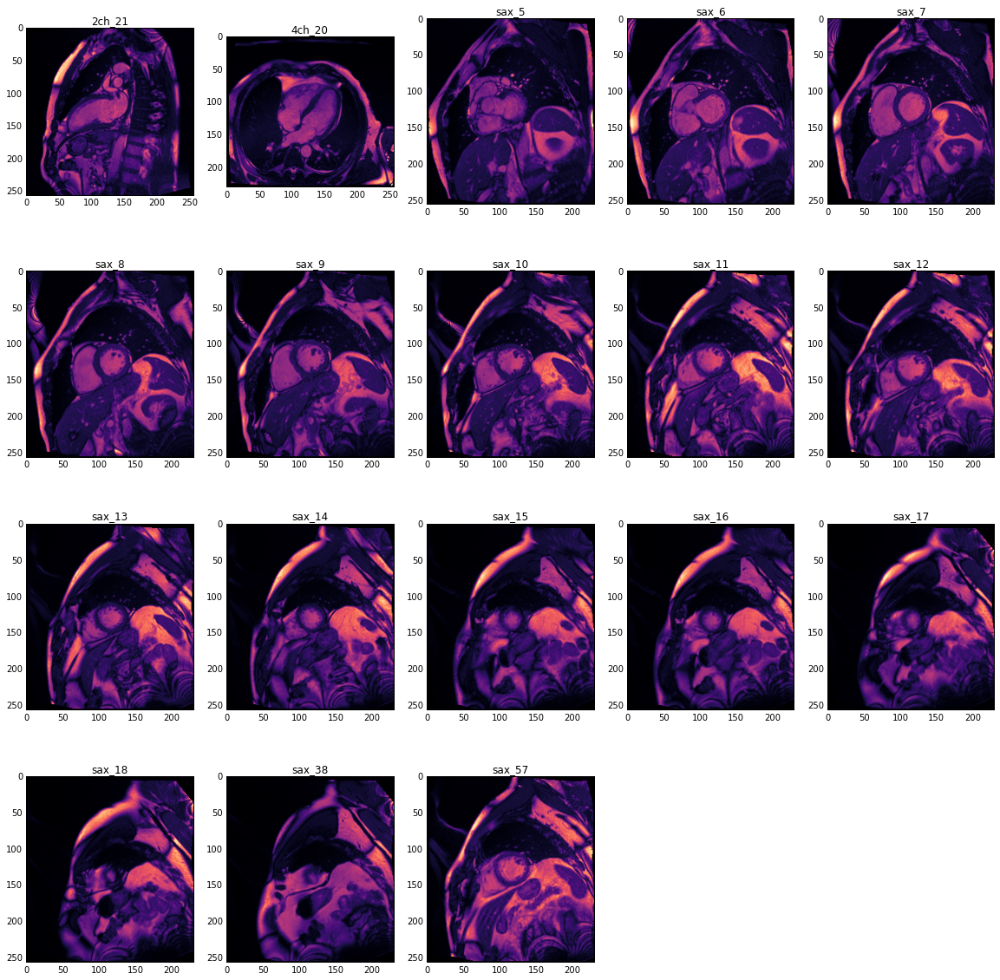

In [37]:
plt.figure(figsize=(20,20))
for n, view in enumerate(natsorted(filepaths_train[1].keys())):
    print(view, end=': ')
    df = dicom.read_file(filepaths_train[1][view][0][1])
    print('{} [loc], {} [thick]'.format(df.SliceLocation, df.SliceThickness))
    plt.subplot(4, 5, n+1)
    plt.title(view)
    plt.imshow(apply_window(df.pixel_array, df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)

2ch_52: 11.773022163906 [loc], 8 [thick]
4ch_54: -3.7118445058427 [loc], 8 [thick]
sax_43: 28.94978808604 [loc], 8 [thick]
sax_44: 38.949787549626 [loc], 8 [thick]
sax_45: 48.949786798095 [loc], 8 [thick]
sax_46: 58.949788618502 [loc], 8 [thick]
sax_47: 68.949787733015 [loc], 8 [thick]
sax_48: 78.949786651828 [loc], 8 [thick]
sax_49: 88.949786092505 [loc], 8 [thick]
sax_50: 98.94979068404 [loc], 8 [thick]


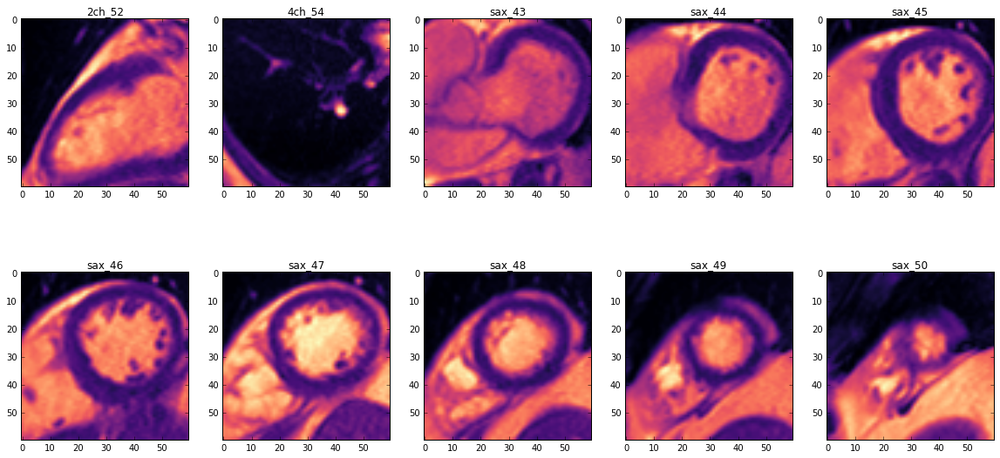

In [38]:
plt.figure(figsize=(20,20))
for n, view in enumerate(natsorted(filepaths_train[3].keys())):
    print(view, end=': ')
    df = dicom.read_file(filepaths_train[3][view][0][1])
    print('{} [loc], {} [thick]'.format(df.SliceLocation, df.SliceThickness))
    plt.subplot(4, 5, n+1)
    plt.title(view)
    plt.imshow(apply_window(df.pixel_array[100:160, 40:100], df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)

sax_37: 43.468095009638 [loc], 8 [thick]
sax_38: 33.468094308792 [loc], 8 [thick]
sax_39: 23.468091785143 [loc], 8 [thick]
sax_40: 13.468089525521 [loc], 8 [thick]
sax_41: 3.4680880385986 [loc], 8 [thick]
sax_42: -6.5319160498316 [loc], 8 [thick]
sax_43: -16.531917536754 [loc], 8 [thick]
sax_44: -26.531920569075 [loc], 8 [thick]
sax_45: -36.531920510598 [loc], 8 [thick]
sax_46: -46.53192354292 [loc], 8 [thick]
['0.7763344871743', '5.78934526E-07', '0.6303211594286', '0.3011902901287', '0.8784485945153', '-0.3709615558601']


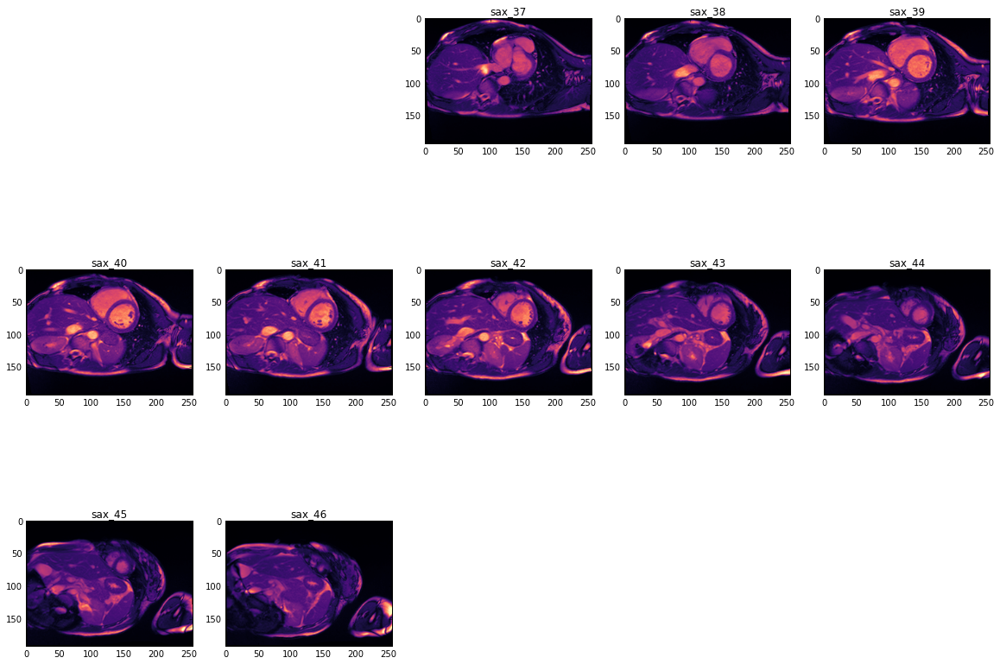

In [45]:
pt = 158
plt.figure(figsize=(20,20))
for n, view in enumerate(natsorted(filepaths_train[pt].keys())):
    if not view.startswith('sax'):
        continue
    print(view, end=': ')
    df = dicom.read_file(filepaths_train[pt][view][0][1])
    print('{} [loc], {} [thick]'.format(float(df.SliceLocation), df.SliceThickness))
    plt.subplot(4, 5, n+1)
    plt.title(view)
    plt.imshow(apply_window(df.pixel_array, df.WindowCenter, df.WindowWidth), cmap=plt.cm.magma)
print(df.ImageOrientationPatient)

['1.40625', '1.40625']


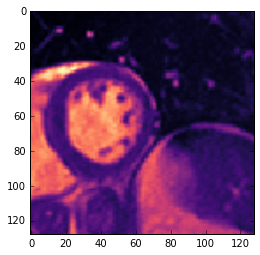

In [14]:
df = dicom.read_file(filepaths_train[3]['sax_45'][0][1])
print(df.PixelSpacing)
img_norm = ndimage.interpolation.zoom(df.pixel_array, [float(x) for x in df.PixelSpacing], order=0, mode='constant')
plt.imshow(img_norm[(img_norm.shape[0]//2 - 64):(img_norm.shape[0]//2+64), (img_norm.shape[1]//2 - 64):(img_norm.shape[1]//2+64)], cmap=plt.cm.magma)